In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import confusion_matrix
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from collections import Counter
import dalex as dx
import eli5
from eli5.sklearn import PermutationImportance
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import random

C:\Users\hp\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
churn_data=pd.read_csv("Telco-Customer-Churn.csv")
churn_data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [3]:
churn_data.shape

(7043, 21)

In [4]:
churn_data.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [5]:
churn_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   gender            7043 non-null   object 
 2   SeniorCitizen     7043 non-null   int64  
 3   Partner           7043 non-null   object 
 4   Dependents        7043 non-null   object 
 5   tenure            7043 non-null   int64  
 6   PhoneService      7043 non-null   object 
 7   MultipleLines     7043 non-null   object 
 8   InternetService   7043 non-null   object 
 9   OnlineSecurity    7043 non-null   object 
 10  OnlineBackup      7043 non-null   object 
 11  DeviceProtection  7043 non-null   object 
 12  TechSupport       7043 non-null   object 
 13  StreamingTV       7043 non-null   object 
 14  StreamingMovies   7043 non-null   object 
 15  Contract          7043 non-null   object 
 16  PaperlessBilling  7043 non-null   object 


In [6]:
churn_data['TotalCharges'] = pd.to_numeric(churn_data['TotalCharges'], errors='coerce')
churn_data["SeniorCitizen"]= churn_data["SeniorCitizen"].map({0: "No", 1: "Yes"})

In [7]:
numerical_col=churn_data.select_dtypes(include=np.number).columns
print("numerical columns: \n",numerical_col)

categorical_col=churn_data.select_dtypes(exclude=np.number).columns
print("categorical columns: \n",categorical_col)

numerical columns: 
 Index(['tenure', 'MonthlyCharges', 'TotalCharges'], dtype='object')
categorical columns: 
 Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity',
       'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV',
       'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod',
       'Churn'],
      dtype='object')


In [8]:
churn_data.drop('customerID',axis=1,inplace=True)

In [9]:
numerical_data=churn_data[['TotalCharges','MonthlyCharges','tenure']]
numerical_data['TotalCharges'].isnull().sum()

11

In [10]:
numerical_data['tenure'].isin([0]).sum()

11

In [11]:
churn_data.loc[:,'TotalCharges'] = churn_data.loc[:,'TotalCharges'].replace(np.nan,0)
churn_data['TotalCharges'].isnull().sum()

0

In [12]:
churn_data=churn_data.replace(to_replace={'Churn':{'Yes':1,'No':0}})

In [13]:
for columns in churn_data.select_dtypes('object').columns:
    print(columns,": \n")
    print(churn_data[columns].value_counts(),"\n")

gender : 

Male      3555
Female    3488
Name: gender, dtype: int64 

SeniorCitizen : 

No     5901
Yes    1142
Name: SeniorCitizen, dtype: int64 

Partner : 

No     3641
Yes    3402
Name: Partner, dtype: int64 

Dependents : 

No     4933
Yes    2110
Name: Dependents, dtype: int64 

PhoneService : 

Yes    6361
No      682
Name: PhoneService, dtype: int64 

MultipleLines : 

No                  3390
Yes                 2971
No phone service     682
Name: MultipleLines, dtype: int64 

InternetService : 

Fiber optic    3096
DSL            2421
No             1526
Name: InternetService, dtype: int64 

OnlineSecurity : 

No                     3498
Yes                    2019
No internet service    1526
Name: OnlineSecurity, dtype: int64 

OnlineBackup : 

No                     3088
Yes                    2429
No internet service    1526
Name: OnlineBackup, dtype: int64 

DeviceProtection : 

No                     3095
Yes                    2422
No internet service    1526
Name: Devi

In [14]:
churn_data.describe()

,tenure,MonthlyCharges,TotalCharges,Churn
count,7043.000000,7043.000000,7043.000000,7043.000000
mean,32.371149,64.761692,2279.734304,0.265370
std,24.559481,30.090047,2266.794470,0.441561
min,0.000000,18.250000,0.000000,0.000000
25%,9.000000,35.500000,398.550000,0.000000
50%,29.000000,70.350000,1394.550000,0.000000
75%,55.000000,89.850000,3786.600000,1.000000
max,72.000000,118.750000,8684.800000,1.000000


In [15]:
x=churn_data.drop('Churn',axis=1)
x.head(2)

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
0,Female,No,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85
1,Male,No,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50


In [16]:
y=churn_data['Churn']

In [17]:
x.dtypes

gender               object
SeniorCitizen        object
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges        float64
dtype: object

In [18]:
multi_cat=[]
Binary_cat=[]
for columns in x.select_dtypes('object').columns:
    #print(columns,": \n")
    if (x[columns].nunique() > 2):
        multi_cat.append(columns)
    else: 
        Binary_cat.append(columns)
          
print(Binary_cat)  
print(multi_cat)

['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'PhoneService', 'PaperlessBilling']
['MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaymentMethod']


In [19]:
le = LabelEncoder()
for i in Binary_cat:
  x[i] = le.fit_transform(x[i])

In [20]:
x=pd.get_dummies(x, columns=multi_cat)
x

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,MultipleLines_No,...,StreamingMovies_No,StreamingMovies_No internet service,StreamingMovies_Yes,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
0,0,0,1,0,1,0,1,29.85,29.85,0,...,1,0,0,1,0,0,0,0,1,0
1,1,0,0,0,34,1,0,56.95,1889.50,1,...,1,0,0,0,1,0,0,0,0,1
2,1,0,0,0,2,1,1,53.85,108.15,1,...,1,0,0,1,0,0,0,0,0,1
3,1,0,0,0,45,0,0,42.30,1840.75,0,...,1,0,0,0,1,0,1,0,0,0
4,0,0,0,0,2,1,1,70.70,151.65,1,...,1,0,0,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1,0,1,1,24,1,1,84.80,1990.50,0,...,0,0,1,0,1,0,0,0,0,1
7039,0,0,1,1,72,1,1,103.20,7362.90,0,...,0,0,1,0,1,0,0,1,0,0
7040,0,0,1,1,11,0,1,29.60,346.45,0,...,1,0,0,1,0,0,0,0,1,0
7041,1,1,1,0,4,1,1,74.40,306.60,0,...,1,0,0,1,0,0,0,0,0,1


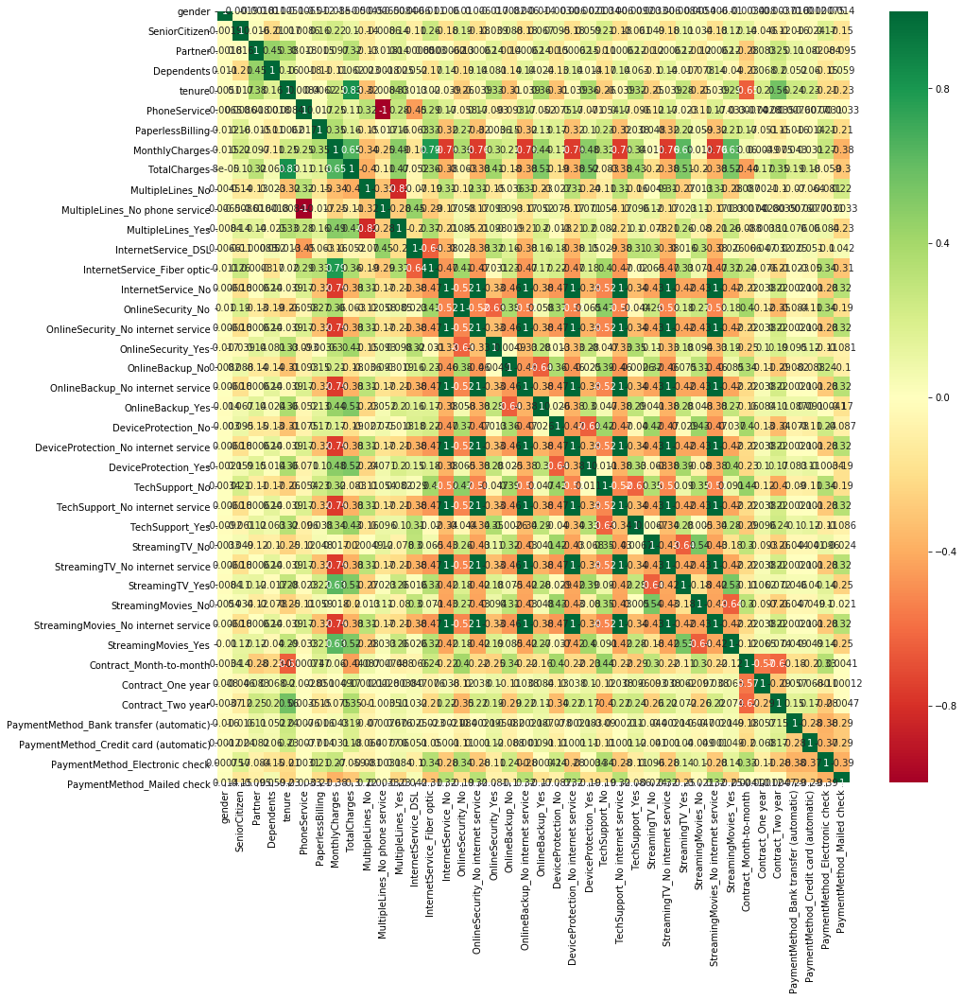

In [21]:
plt.figure(figsize=(15,15))
p=sns.heatmap(x.corr(),annot=True,cmap='RdYlGn',center=0)

In [22]:
x.drop(columns=['StreamingTV_No internet service','StreamingMovies_No internet service',
      'TechSupport_No internet service','DeviceProtection_No internet service',
      'OnlineBackup_No internet service','OnlineSecurity_No internet service',
      'InternetService_No','MultipleLines_No phone service'],inplace=True)

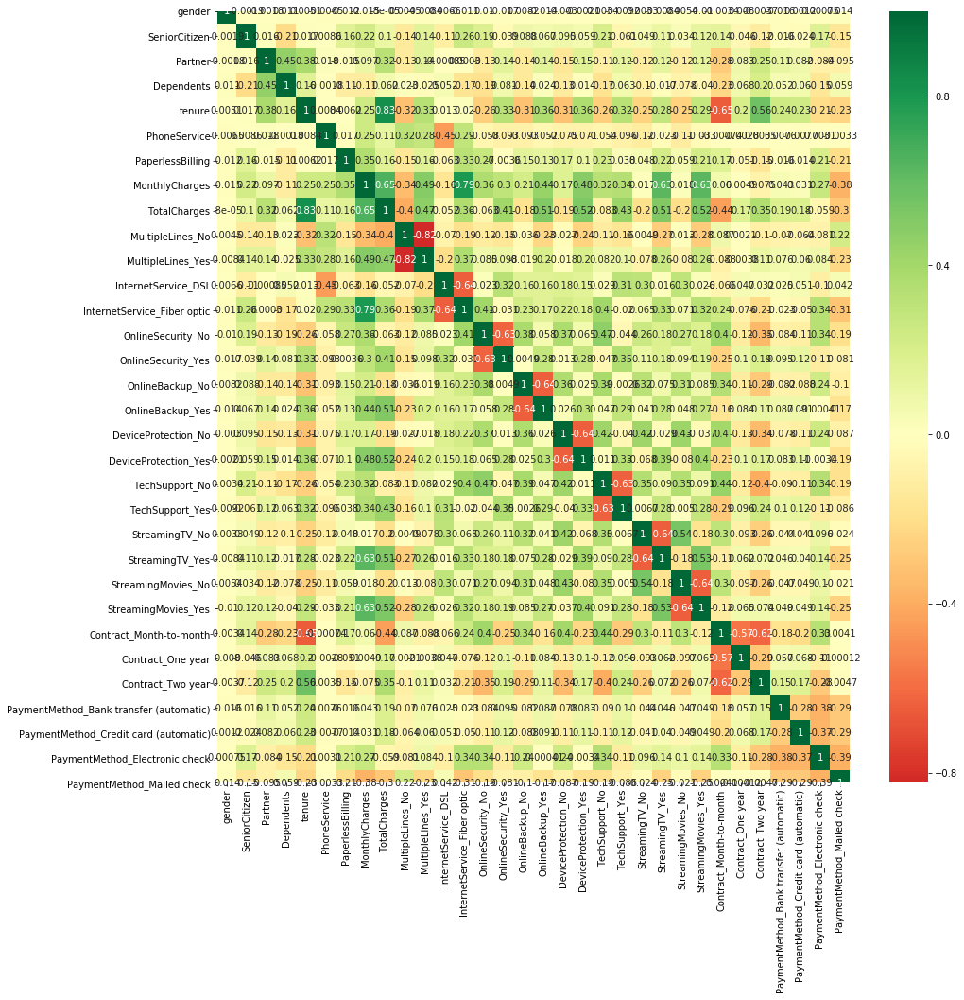

In [23]:
plt.figure(figsize=(15,15))
p=sns.heatmap(x.corr(),annot=True,cmap='RdYlGn',center=0)

In [24]:
X_train,X_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=99)

In [25]:
ct = ColumnTransformer([

        ('somename', StandardScaler(), ['tenure', 'MonthlyCharges', 'TotalCharges'])

    ], remainder='passthrough')

In [26]:
y_train.count()

4930

In [27]:
y_test.value_counts()

0    1552
1     561
Name: Churn, dtype: int64

# Logistic regression

In [28]:
clf_log= Pipeline([('transformer', ct),
                ('classifier', LogisticRegression())
               ])
clf_log.fit(X_train,y_train)
y_predict=clf_log.predict(X_test)


print ("Accuracy: \n",metrics.accuracy_score(y_test,y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict))
print("\n classification report: \n",metrics.classification_report(y_test,y_predict))

Accuracy: 
 0.8031235210601041

 confusion_matrix: 
 [[1400  152]
 [ 264  297]]

 classification report: 
               precision    recall  f1-score   support

           0       0.84      0.90      0.87      1552
           1       0.66      0.53      0.59       561

    accuracy                           0.80      2113
   macro avg       0.75      0.72      0.73      2113
weighted avg       0.79      0.80      0.80      2113



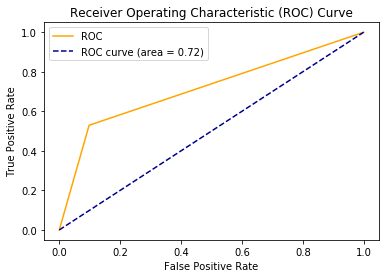

In [29]:
auc=roc_auc_score(y_test, y_predict)
fpr, tpr,thresholds = roc_curve(y_test, y_predict)
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

In [30]:
clf_log= Pipeline([('transformer', ct),
                ('classifier', LogisticRegression(class_weight="balanced"))
               ])
clf_log.fit(X_train,y_train)
y_predict=clf_log.predict(X_test)
print ("Accuracy: \n",metrics.accuracy_score(y_test,y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict))
print("\n classification report: \n",metrics.classification_report(y_test,y_predict))
print(y_train.value_counts())

Accuracy: 
 0.7496450544249882

 confusion_matrix: 
 [[1132  420]
 [ 109  452]]

 classification report: 
               precision    recall  f1-score   support

           0       0.91      0.73      0.81      1552
           1       0.52      0.81      0.63       561

    accuracy                           0.75      2113
   macro avg       0.72      0.77      0.72      2113
weighted avg       0.81      0.75      0.76      2113

0    3622
1    1308
Name: Churn, dtype: int64


class imbalance

0    5174
1    1869
Name: Churn, dtype: int64


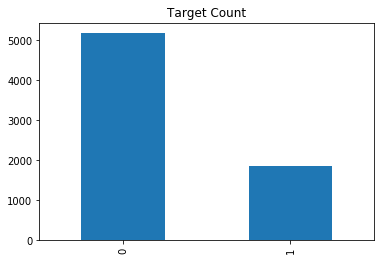

In [31]:
target=y.value_counts()
print(target)
target.plot(kind='bar', title='Target Count');

In [32]:
from imblearn.under_sampling import RandomUnderSampler
ros = RandomUnderSampler()
X_rus, y_rus = ros.fit_resample(x, y)
X_train_rus,X_test_rus,y_train_rus,y_test_rus=train_test_split(X_rus, y_rus,test_size=0.3,
                                                               random_state=99)
clf_log.fit(X_train_rus,y_train_rus)
y_predict_rus=clf_log.predict(X_test_rus)

print(y_train_rus.shape,y_test_rus.shape)
print("original shape",Counter(y))
print("random under sampled shape",Counter(y_rus))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_rus,y_predict_rus))
print("Accuracy score:",metrics.accuracy_score(y_test_rus, y_predict_rus))
print("classification_report:\n",metrics.classification_report(y_test_rus, y_predict_rus))

(2616,) (1122,)
original shape Counter({0: 5174, 1: 1869})
random under sampled shape Counter({0: 1869, 1: 1869})

 confusion_matrix: 
 [[422 143]
 [114 443]]
Accuracy score: 0.7709447415329769
classification_report:
               precision    recall  f1-score   support

           0       0.79      0.75      0.77       565
           1       0.76      0.80      0.78       557

    accuracy                           0.77      1122
   macro avg       0.77      0.77      0.77      1122
weighted avg       0.77      0.77      0.77      1122



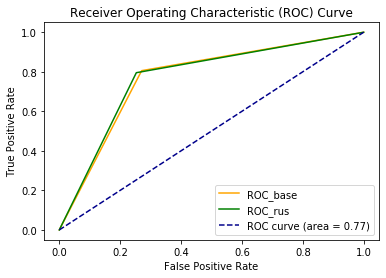

In [33]:
auc=roc_auc_score(y_test, y_predict)
fpr1, tpr1,thresholds1 = roc_curve(y_test, y_predict)
fpr2, tpr2,thresholds2 = roc_curve(y_test_rus, y_predict_rus)
plt.plot(fpr1, tpr1, color='orange', label='ROC_base')
plt.plot(fpr2, tpr2, color='green', label='ROC_rus')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

In [34]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler()
X_ros, y_ros = ros.fit_resample(x, y)
X_train_ros,X_test_ros,y_train_ros,y_test_ros=train_test_split(X_ros, y_ros,test_size=0.3,
                                                               random_state=99)
clf_log.fit(X_train_ros,y_train_ros)
y_predict_ros=clf_log.predict(X_test_ros)

print(y_train_ros.shape,y_test_ros.shape)
print("original shape",Counter(y))
print("random over sampled shape",Counter(y_ros))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict_ros))
print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict_ros))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict_ros))
#_, ax = plt.subplots(figsize=(6, 6))
#ax.scatter(X_ros.iloc[:, 0], X_ros.iloc[:, 1], c=y_ros,alpha=0.8, edgecolor="k")

(7243,) (3105,)
original shape Counter({0: 5174, 1: 1869})
random over sampled shape Counter({0: 5174, 1: 5174})

 confusion_matrix: 
 [[1122  412]
 [ 276 1295]]
Accuracy score: 0.7784219001610306
classification_report:
               precision    recall  f1-score   support

           0       0.80      0.73      0.77      1534
           1       0.76      0.82      0.79      1571

    accuracy                           0.78      3105
   macro avg       0.78      0.78      0.78      3105
weighted avg       0.78      0.78      0.78      3105



In [151]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 2)
X_sm, y_sm = sm.fit_resample(x,y)
X_train_sm,X_test_sm,y_train_sm,y_test_sm=train_test_split(X_sm, y_sm,test_size=0.3,random_state=99)
clf_log.fit(X_train_sm,y_train_sm)
y_predict_sm=clf_log.predict(X_test_sm)

print("original shape",Counter(y))
print("SMOTE sampled shape",Counter(y_sm))
print(y_train_sm.shape,y_test_sm.shape)
print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict_sm))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm, y_predict_sm))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict_sm))


original shape Counter({0: 5174, 1: 1869})
SMOTE sampled shape Counter({0: 5174, 1: 5174})
(7243,) (3105,)
Accuracy score: 0.8460547504025765

 confusion_matrix: 
 [[1311  223]
 [ 255 1316]]
classification_report:
               precision    recall  f1-score   support

           0       0.84      0.85      0.85      1534
           1       0.86      0.84      0.85      1571

    accuracy                           0.85      3105
   macro avg       0.85      0.85      0.85      3105
weighted avg       0.85      0.85      0.85      3105



C:\Users\hp\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:765: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [36]:
from imblearn.over_sampling import ADASYN
ada=ADASYN()
X_ada, y_ada = ada.fit_resample(x,y)
X_train_ada,X_test_ada,y_train_ada,y_test_ada=train_test_split(X_ada, y_ada,test_size=0.3,random_state=99)
clf_log.fit(X_train_ada,y_train_ada)
y_predict_ada=clf_log.predict(X_test_ada)

print("original shape",Counter(y))
print("ADASYN sampled shape",Counter(y_ada))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ada, y_predict_ada))
print("Accuracy score:",metrics.accuracy_score(y_test_ada, y_predict_ada))
print("classification_report:\n",metrics.classification_report(y_test_ada, y_predict_ada))

original shape Counter({0: 5174, 1: 1869})
ADASYN sampled shape Counter({1: 5234, 0: 5174})

 confusion_matrix: 
 [[1349  189]
 [ 267 1318]]
Accuracy score: 0.8539865513928915
classification_report:
               precision    recall  f1-score   support

           0       0.83      0.88      0.86      1538
           1       0.87      0.83      0.85      1585

    accuracy                           0.85      3123
   macro avg       0.85      0.85      0.85      3123
weighted avg       0.85      0.85      0.85      3123



C:\Users\hp\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:765: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


In [37]:
d = {'feature': X_train_sm.columns, 'coefficient': clf_log['classifier'].coef_[0], 'odds': np.exp(clf_log['classifier'].coef_[0])}
df = pd.DataFrame(data=d)
df.sort_values(by='odds', ascending=False)

,feature,coefficient,odds
1,SeniorCitizen,3.926453,50.726730
11,InternetService_DSL,1.852711,6.377083
2,Partner,1.123831,3.076617
8,TotalCharges,0.164975,1.179363
4,tenure,0.037035,1.037730
5,PhoneService,-0.134387,0.874252
3,Dependents,-0.156840,0.854840
23,StreamingMovies_No,-0.277913,0.757363
6,PaperlessBilling,-0.381307,0.682968
21,StreamingTV_No,-0.663782,0.514900


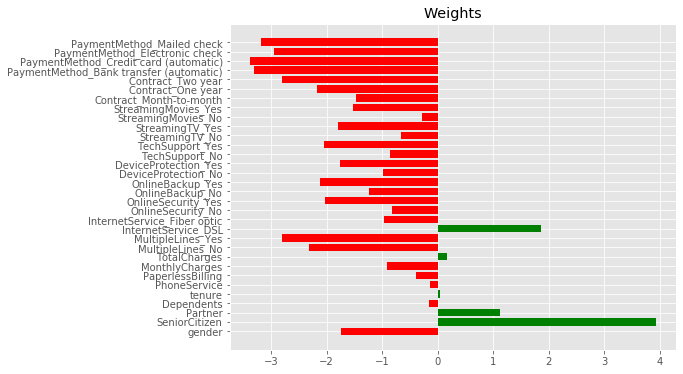

In [38]:
with plt.style.context("ggplot"):
    fig = plt.figure(figsize=(8,6))
    plt.barh(range(len(clf_log['classifier'].coef_[0])), clf_log['classifier'].coef_[0], color=["red" if coef<0 else "green" for coef in clf_log['classifier'].coef_[0]])
    plt.yticks(range(len(clf_log['classifier'].coef_[0])), X_train_sm.columns);
    plt.title("Weights")

In [39]:
import lime
from lime import lime_tabular

explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train_sm),
    feature_names=X_train_sm.columns,
    mode='classification',
    class_names=['non-churn', 'churn']
)

In [40]:
i=105
print("Actual:",y_test_sm.iloc[i])
exp = explainer.explain_instance(
    data_row=X_test_sm.iloc[i],
    predict_fn=clf_log['classifier'].predict_proba
)
exp.show_in_notebook(show_table=True)

Actual: 1


In [41]:
import shap
shap.initjs()
shap_explainer = shap.LinearExplainer(clf_log['classifier'],masker=shap.maskers.Impute(data=X_train_sm))
shap_values = shap_explainer(X_test_sm)

Estimating transforms:   0%|          | 0/1000 [00:00<?, ?it/s]

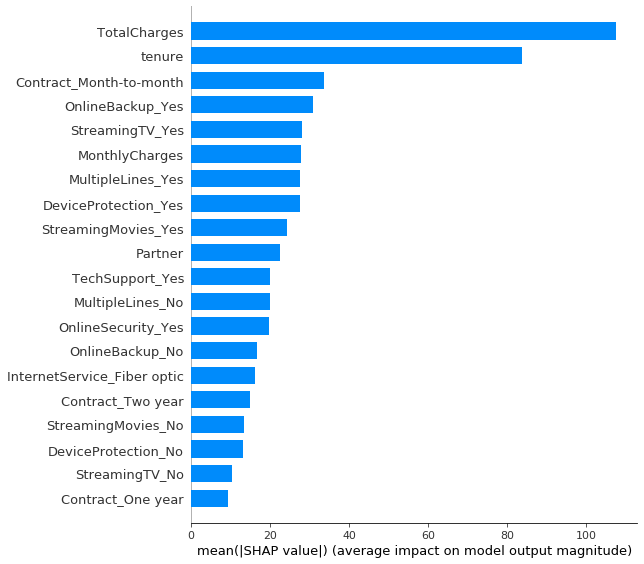

In [42]:
shap.summary_plot(shap_values, X_test_sm, plot_type="bar")

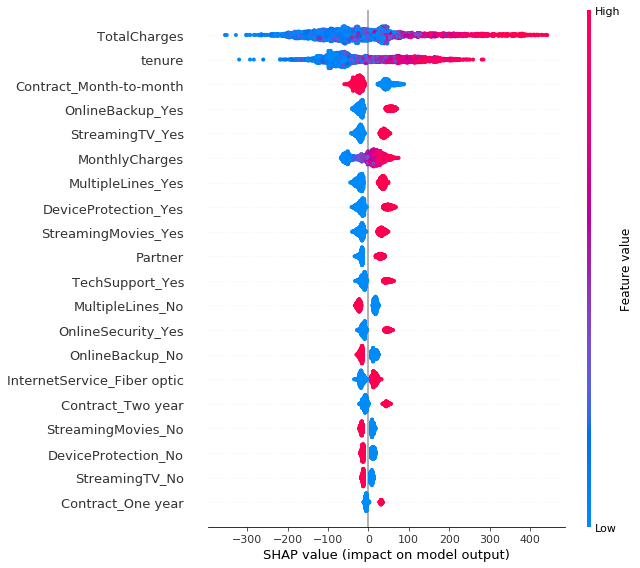

In [43]:
shap.summary_plot(shap_values, X_test_sm)

In [44]:
shap.plots.force(shap_values[0])

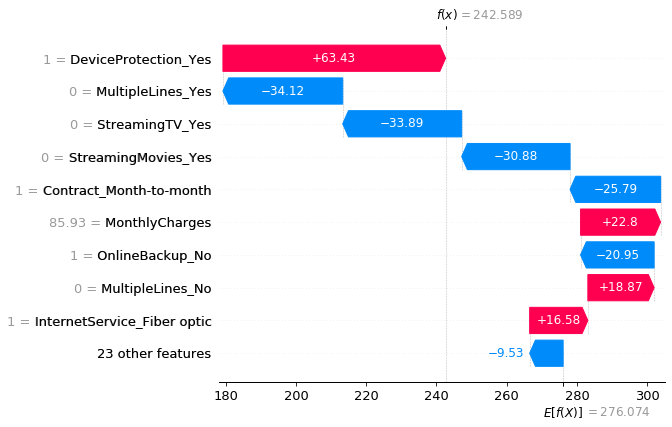

In [45]:
shap.plots.waterfall(shap_values[0])

In [46]:
import dalex as dx

In [47]:
def protected_values(X):
    x_new=X.copy()
    y_new=X.copy()
    x_new['gender']=x_new['gender'].map({0: "female", 1: "male"})
    y_new['SeniorCitizen']=y_new['SeniorCitizen'].map({0: "young", 1: "old"})
    protected=x_new['gender']+y_new['SeniorCitizen']
    return protected;

In [48]:
exp_logreg = dx.Explainer(clf_log,x,y)
exp_logreg.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 7043 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 7043 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.000919, mean = 0.292, max = 0.864
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.825, mean = -0.0265, max = 0.997
  -> model_info        : package sklearn

A new explainer has been created!


,recall,precision,f1,accuracy,auc
LogisticRegression,0.596041,0.62479,0.610077,0.797813,0.841175


In [49]:
fobject_logreg = exp_logreg.model_fairness(protected = protected_values(x), privileged='maleyoung')
fobject_logreg.result
fobject_logreg.fairness_check(epsilon = 0.8)

Bias detected in 3 metrics: TPR, FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acceptable limits set by epsilon.

Ratios of metrics, based on 'maleyoung'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                  TPR       ACC       PPV       FPR       STP
femaleold    1.378327  0.884521  1.055016  2.868687  2.373737
femaleyoung  1.131179  0.993857  0.972492  1.252525  1.196970
maleold      1.281369  0.905405  1.103560  2.212121  2.050505


In [50]:
fobject_logreg.metric_scores

,TPR,TNR,PPV,NPV,FNR,FPR,FDR,FOR,ACC,STP
femaleold,0.725,0.716,0.652,0.781,0.275,0.284,0.348,0.219,0.720,0.470
femaleyoung,0.595,0.876,0.601,0.873,0.405,0.124,0.399,0.127,0.809,0.237
maleold,0.674,0.781,0.682,0.774,0.326,0.219,0.318,0.226,0.737,0.406
maleyoung,0.526,0.901,0.618,0.862,0.474,0.099,0.382,0.138,0.814,0.198


In [51]:
fobject_logreg.plot()

In [188]:
exp_logreg_rus = dx.Explainer(clf_log,X_rus,y_rus)
fobject_logreg_rus = exp_logreg_rus.model_fairness(protected = protected_values(X_rus), privileged='maleyoung')
fobject_logreg_rus.fairness_check(epsilon = 0.8)
fobject_logreg_rus.metric_scores
fobject_logreg_rus.plot()
exp_logreg_rus.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 3738 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3738 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.000628, mean = 0.376, max = 0.879
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.847, mean = 0.124, max = 0.998
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 3 metrics: TPR, FPR, STP

Conclusion: your model is not fair because 2 

,recall,precision,f1,accuracy,auc
LogisticRegression,0.615302,0.814448,0.701006,0.73756,0.840233


In [186]:
exp_logreg_ros = dx.Explainer(clf_log,X_ros,y_ros)
fobject_logreg_ros = exp_logreg_ros.model_fairness(protected = protected_values(X_ros), privileged='maleyoung')
fobject_logreg_ros.fairness_check(epsilon = 0.8)
fobject_logreg_ros.metric_scores
fobject_logreg_ros.plot()
exp_logreg_ros.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.000628, mean = 0.373, max = 0.879
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.856, mean = 0.127, max = 0.998
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 3 metrics: TPR, FPR, STP

Conclusion: your model is not fair because 

,recall,precision,f1,accuracy,auc
LogisticRegression,0.608813,0.81564,0.697211,0.735601,0.84015


In [185]:
exp_logreg_sm = dx.Explainer(clf_log,X_sm,y_sm)
fobject_logreg_sm = exp_logreg_sm.model_fairness(protected = protected_values(X_sm), privileged='maleyoung')
fobject_logreg_sm.fairness_check(epsilon = 0.8)
fobject_logreg_sm.metric_scores
fobject_logreg_sm.plot()
exp_logreg_sm.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.000628, mean = 0.499, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.856, mean = 0.00068, max = 0.998
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or 

,recall,precision,f1,accuracy,auc
LogisticRegression,0.839003,0.859094,0.848929,0.850696,0.935735


In [190]:
exp_logreg_ada = dx.Explainer(clf_log,X_ada,y_ada)
fobject_logreg_ada = exp_logreg_ada.model_fairness(protected = protected_values(X_ada), privileged='maleyoung')
fobject_logreg_ada.fairness_check(epsilon = 0.8)
fobject_logreg_ada.metric_scores
fobject_logreg_ada.plot()
exp_logreg_ada.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10408 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10408 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.000628, mean = 0.503, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.856, mean = 0.00018, max = 0.998
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or 

,recall,precision,f1,accuracy,auc
LogisticRegression,0.83569,0.860008,0.847674,0.848962,0.934995


# Decision tree 

In [56]:
from sklearn.tree import DecisionTreeClassifier
X_train,X_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=0)
clf_decision = Pipeline([('transformer', ct),
                ('classifier', DecisionTreeClassifier())
               ])
clf_decision.fit(X_train,y_train)
y_predict_dt=clf_decision.predict(X_test)

print ("Accuracy: \n",metrics.accuracy_score(y_test,y_predict_dt))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict_dt,labels = [0, 1]))
print("\n classification report: \n",metrics.classification_report(y_test,y_predict_dt,labels = [0, 1]))

Accuracy: 
 0.7141504969238051

 confusion_matrix: 
 [[1249  311]
 [ 293  260]]

 classification report: 
               precision    recall  f1-score   support

           0       0.81      0.80      0.81      1560
           1       0.46      0.47      0.46       553

    accuracy                           0.71      2113
   macro avg       0.63      0.64      0.63      2113
weighted avg       0.72      0.71      0.72      2113



In [57]:
from sklearn import tree
text_representation = tree.export_text(clf_decision['classifier'])
print(text_representation)

|--- feature_25 <= 0.50
|   |--- feature_1 <= 0.96
|   |   |--- feature_13 <= 0.50
|   |   |   |--- feature_30 <= 0.50
|   |   |   |   |--- feature_1 <= -0.02
|   |   |   |   |   |--- feature_2 <= -0.95
|   |   |   |   |   |   |--- feature_2 <= -0.95
|   |   |   |   |   |   |   |--- feature_2 <= -0.99
|   |   |   |   |   |   |   |   |--- feature_2 <= -0.99
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |--- feature_2 >  -0.99
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- feature_2 >  -0.99
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- feature_2 >  -0.95
|   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- feature_2 >  -0.95
|   |   |   |   |   |   |--- feature_0 <= 1.11
|   |   |   |   |   |   |   |--- feature_0 <= 0.82
|   |   |   |   |   |   |   |   |--- feature_10 <= 0.50
|   |   |   |   |   |   |   |   |   |--- feature_2 <= -0.84
|   |   |   |   |   |   |   |   |   |  

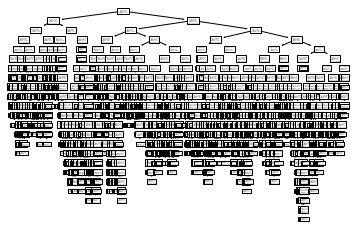

In [58]:
fig = clf_decision['classifier'].fit(X_train,y_train)
tree.plot_tree(fig)
plt.show()

In [59]:
dotfile = open("fig.dot", 'w')
tree.export_graphviz(fig, out_file=dotfile, feature_names=x.columns)
dotfile.close()

In [60]:
df['importances_tree'] = clf_decision['classifier'].feature_importances_
df.sort_values('importances_tree', ascending=False)

,feature,coefficient,odds,importances_tree
7,MonthlyCharges,-0.909687,0.402650,0.190528
25,Contract_Month-to-month,-1.474822,0.228819,0.174832
8,TotalCharges,0.164975,1.179363,0.171851
4,tenure,0.037035,1.037730,0.127399
12,InternetService_Fiber optic,-0.960006,0.382890,0.048084
1,SeniorCitizen,3.926453,50.726730,0.027695
6,PaperlessBilling,-0.381307,0.682968,0.026081
0,gender,-1.736562,0.176125,0.023493
2,Partner,1.123831,3.076617,0.020412
3,Dependents,-0.156840,0.854840,0.020330


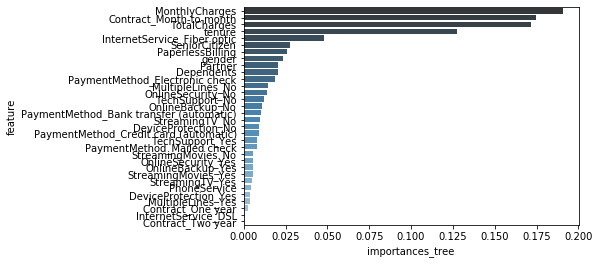

In [61]:
sns.barplot(x="importances_tree", y="feature", 
           data=df.sort_values('importances_tree', ascending=False), palette="Blues_d")

# class imbalance

In [62]:
from imblearn.under_sampling import RandomUnderSampler
ros = RandomUnderSampler()
X_rus, y_rus = ros.fit_resample(x, y)
X_train_rus,X_test_rus,y_train_rus,y_test_rus=train_test_split(X_rus, y_rus,test_size=0.3,random_state=0)
clf_decision.fit(X_train_rus,y_train_rus)
y_predict_rus=clf_decision.predict(X_test_rus)

print("original shape",Counter(y))
print("random under sampled shape",Counter(y_rus))
print("Accuracy score:",metrics.accuracy_score(y_test_rus, y_predict_rus))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_rus,y_predict_rus,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_rus, y_predict_rus))

original shape Counter({0: 5174, 1: 1869})
random under sampled shape Counter({0: 1869, 1: 1869})
Accuracy score: 0.6800356506238859

 confusion_matrix: 
 [[384 177]
 [182 379]]
classification_report:
               precision    recall  f1-score   support

           0       0.68      0.68      0.68       561
           1       0.68      0.68      0.68       561

    accuracy                           0.68      1122
   macro avg       0.68      0.68      0.68      1122
weighted avg       0.68      0.68      0.68      1122



In [63]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler()
X_ros, y_ros = ros.fit_resample(x, y)
print("original shape",Counter(y))
print("random over sampled shape",Counter(y_ros))
X_train_ros,X_test_ros,y_train_ros,y_test_ros=train_test_split(X_ros, y_ros,test_size=0.3,random_state=99)
clf_decision.fit(X_train_ros,y_train_ros)
y_predict_ros=clf_decision.predict(X_test_ros)
print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict_ros))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict_ros,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict_ros))

original shape Counter({0: 5174, 1: 1869})
random over sampled shape Counter({0: 5174, 1: 5174})
Accuracy score: 0.8595813204508856

 confusion_matrix: 
 [[1222  312]
 [ 124 1447]]
classification_report:
               precision    recall  f1-score   support

           0       0.91      0.80      0.85      1534
           1       0.82      0.92      0.87      1571

    accuracy                           0.86      3105
   macro avg       0.87      0.86      0.86      3105
weighted avg       0.86      0.86      0.86      3105



In [64]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 2)
X_sm, y_sm = sm.fit_resample(x,y)
print("original shape",Counter(y))
print("SMOTE sampled shape",Counter(y_sm))
X_train_sm,X_test_sm,y_train_sm,y_test_sm=train_test_split(X_sm, y_sm,test_size=0.3,random_state=0)
clf_decision.fit(X_train_sm,y_train_sm)
y_predict_sm=clf_decision.predict(X_test_sm)
print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict_sm))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict_sm,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict_sm))

original shape Counter({0: 5174, 1: 1869})
SMOTE sampled shape Counter({0: 5174, 1: 5174})
Accuracy score: 0.8090177133655394

 confusion_matrix: 
 [[1245  302]
 [ 291 1267]]
classification_report:
               precision    recall  f1-score   support

           0       0.81      0.80      0.81      1547
           1       0.81      0.81      0.81      1558

    accuracy                           0.81      3105
   macro avg       0.81      0.81      0.81      3105
weighted avg       0.81      0.81      0.81      3105



In [65]:
from imblearn.over_sampling import ADASYN
ada=ADASYN()
X_ada, y_ada = ada.fit_resample(x,y)
print("original shape",Counter(y))
print("ADASYN sampled shape",Counter(y_ada))
X_train_ada,X_test_ada,y_train_ada,y_test_ada=train_test_split(X_ada, y_ada,test_size=0.3,random_state=0)
clf_decision.fit(X_train_ada,y_train_ada)
y_predict_ada=clf_decision.predict(X_test_ada)
print("Accuracy score:",metrics.accuracy_score(y_test_ada, y_predict_ada))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ada,y_predict_ada,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ada, y_predict_ada))

original shape Counter({0: 5174, 1: 1869})
ADASYN sampled shape Counter({1: 5234, 0: 5174})
Accuracy score: 0.8040345821325648

 confusion_matrix: 
 [[1247  318]
 [ 294 1264]]
classification_report:
               precision    recall  f1-score   support

           0       0.81      0.80      0.80      1565
           1       0.80      0.81      0.81      1558

    accuracy                           0.80      3123
   macro avg       0.80      0.80      0.80      3123
weighted avg       0.80      0.80      0.80      3123



# Permutation feature importance

In [66]:
perm = PermutationImportance(clf_decision).fit(x,y)
eli5.show_weights(perm,feature_names=x.columns.tolist())

Weight,Feature
0.2189 ± 0.0050,Contract_Two year
0.2033 ± 0.0089,MonthlyCharges
0.1732 ± 0.0033,Contract_One year
0.1446 ± 0.0037,tenure
0.1411 ± 0.0044,TotalCharges
0.1108 ± 0.0050,Contract_Month-to-month
0.0949 ± 0.0056,OnlineSecurity_Yes
0.0769 ± 0.0039,OnlineBackup_Yes
0.0565 ± 0.0027,TechSupport_Yes
0.0524 ± 0.0047,MultipleLines_No


# LIME

In [67]:
i=108

print("Actual" , y_test_sm.iloc[i])
exp = explainer.explain_instance(
    data_row=X_test_sm.iloc[i], 
    predict_fn=clf_decision['classifier'].predict_proba
)
exp.show_in_notebook(show_table=True)

Actual 0


# SHAP

In [68]:
shap.initjs()
shap_explainer = shap.TreeExplainer(clf_decision['classifier'])
shap_values = shap_explainer.shap_values(X_test)
shap.force_plot(shap_explainer.expected_value[y_test.iloc[1]], shap_values[1][1], X_test.iloc[1], feature_names=X_train.columns)

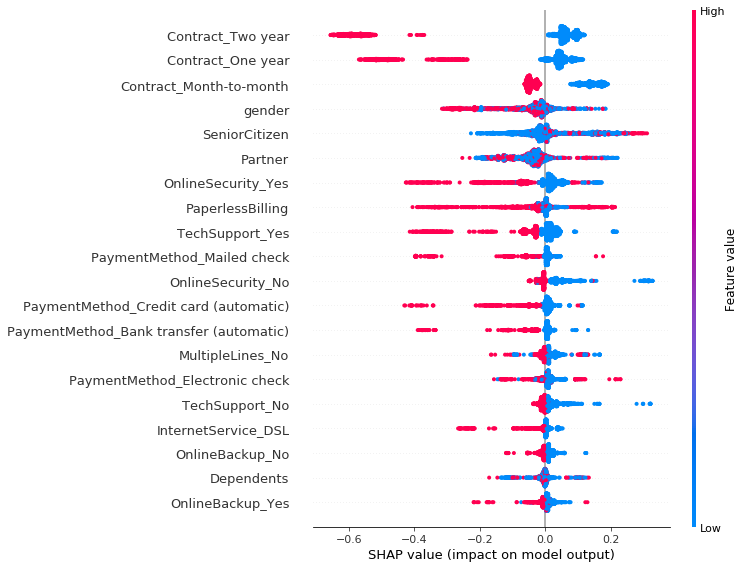

In [69]:
shap.summary_plot(shap_values[1], X_test)

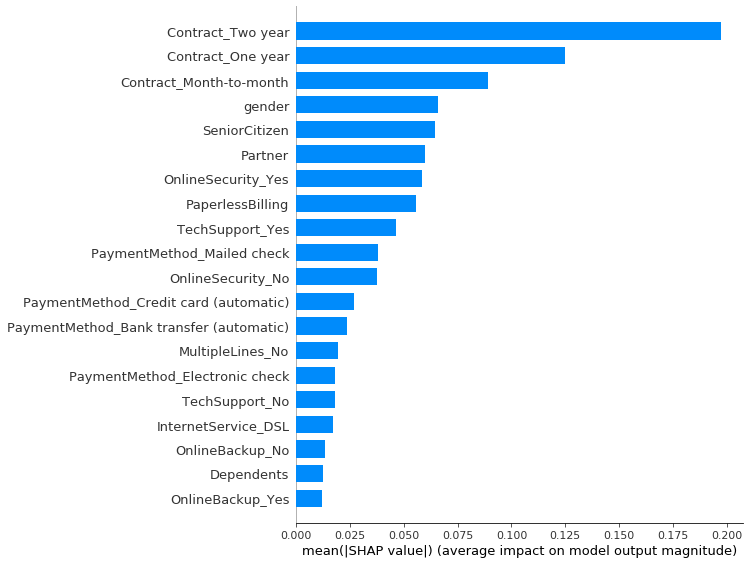

In [70]:
shap.summary_plot(shap_values[1], X_test, plot_type="bar")

In [71]:
exp_decision = dx.Explainer(clf_decision,x,y,verbose = False)
fobject= exp_decision.model_fairness(protected = protected_values(x), privileged='maleyoung')
fobject.fairness_check(epsilon = 0.8)

Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acceptable limits set by epsilon.

Ratios of metrics, based on 'maleyoung'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                  TPR       ACC       PPV       FPR       STP
femaleold    1.018540  0.961998  1.055624  1.774194  1.754032
femaleyoung  1.015064  1.007600  1.029666  0.887097  1.016129
maleold      1.020857  0.966341  1.058096  1.677419  1.705645


In [72]:
exp_decision.model_performance()

,recall,precision,f1,accuracy,auc
DecisionTreeClassifier,0.872124,0.829517,0.850287,0.918501,0.90574


In [73]:
fobject.result

,TPR,TNR,PPV,NPV,FNR,FPR,FDR,FOR,ACC,STP
femaleold,1.018540,0.948827,1.055624,0.949896,0.883212,1.774194,0.764398,2.142857,0.961998,1.754032
femaleyoung,1.015064,1.007463,1.029666,1.002088,0.905109,0.887097,0.874346,0.952381,1.007600,1.016129
maleold,1.020857,0.955224,1.058096,0.955115,0.868613,1.677419,0.753927,2.023810,0.966341,1.705645
maleyoung,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [74]:
fobject.plot()

In [75]:
exp_decision_rus = dx.Explainer(clf_decision,X_rus,y_rus)
exp_decision_rus.model_performance().result
fobject_rus= exp_decision_rus.model_fairness(protected = protected_values(X_rus), privileged='maleyoung')
fobject_rus.fairness_check(epsilon = 0.8)
fobject_rus.metric_scores
fobject_rus.plot()

Preparation of a new explainer is initiated

  -> data              : 3738 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3738 values
  -> model_class       : sklearn.tree._classes.DecisionTreeClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.465, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.0349, max = 1.0
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exc

In [76]:
exp_decision_ros = dx.Explainer(clf_decision,X_ros,y_ros)
exp_decision_ros.model_performance().result
fobject_ros = exp_decision_ros.model_fairness(protected = protected_values(X_ros), privileged='maleyoung')
fobject_ros.fairness_check(epsilon = 0.8)
fobject_ros.metric_scores
fobject_ros.plot()
exp_decision_ros.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.tree._classes.DecisionTreeClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.464, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.0363, max = 1.0
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria e

,recall,precision,f1,accuracy,auc
DecisionTreeClassifier,0.867801,0.93057,0.89809,0.901527,0.934425


In [77]:
exp_decision_sm = dx.Explainer(clf_decision,X_sm,y_sm)
exp_decision_sm.model_performance().result
fobject_sm = exp_decision_sm.model_fairness(protected = protected_values(X_sm), privileged='maleyoung')
fobject_sm.fairness_check(epsilon = 0.8)
fobject_sm.metric_scores
fobject_sm.plot()
exp_decision_sm.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.tree._classes.DecisionTreeClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.495, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.00503, max = 1.0
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria 

,recall,precision,f1,accuracy,auc
DecisionTreeClassifier,0.929842,0.934901,0.932364,0.932547,0.940384


In [78]:
exp_decision_ada = dx.Explainer(clf_decision,X_ada,y_ada)
exp_decision_ada.model_performance().result
fobject_ada = exp_decision_ada.model_fairness(protected = protected_values(X_ada), privileged='maleyoung')
fobject_ada.fairness_check(epsilon = 0.8)
fobject_ada.metric_scores
fobject_ada.plot()
exp_decision_ada.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10408 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10408 values
  -> model_class       : sklearn.tree._classes.DecisionTreeClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.506, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = -0.00264, max = 1.0
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria

,recall,precision,f1,accuracy,auc
DecisionTreeClassifier,0.944402,0.936529,0.940449,0.939854,0.952197


# Random forest

In [79]:
from sklearn.ensemble import RandomForestClassifier
clf_randforest = Pipeline([('transformer',ct),
                ('classifier', RandomForestClassifier())
               ])
clf_randforest.fit(X_train,y_train)
y_predict=clf_randforest.predict(X_test)


print("Accuracy score:",metrics.accuracy_score(y_test, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test, y_predict))

Accuracy score: 0.7860861334595362

 confusion_matrix: 
 [[1384  176]
 [ 276  277]]
classification_report:
               precision    recall  f1-score   support

           0       0.83      0.89      0.86      1560
           1       0.61      0.50      0.55       553

    accuracy                           0.79      2113
   macro avg       0.72      0.69      0.71      2113
weighted avg       0.78      0.79      0.78      2113



In [80]:
clf_randforest.fit(X_train_rus,y_train_rus)
y_predict=clf_randforest.predict(X_test_rus)

print("Accuracy score:",metrics.accuracy_score(y_test_rus, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_rus,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_rus, y_predict))

Accuracy score: 0.7468805704099821

 confusion_matrix: 
 [[423 138]
 [146 415]]
classification_report:
               precision    recall  f1-score   support

           0       0.74      0.75      0.75       561
           1       0.75      0.74      0.75       561

    accuracy                           0.75      1122
   macro avg       0.75      0.75      0.75      1122
weighted avg       0.75      0.75      0.75      1122



In [81]:
clf_randforest.fit(X_train_ros,y_train_ros)
y_predict=clf_randforest.predict(X_test_ros)

print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict))

Accuracy score: 0.8859903381642512

 confusion_matrix: 
 [[1268  266]
 [  88 1483]]
classification_report:
               precision    recall  f1-score   support

           0       0.94      0.83      0.88      1534
           1       0.85      0.94      0.89      1571

    accuracy                           0.89      3105
   macro avg       0.89      0.89      0.89      3105
weighted avg       0.89      0.89      0.89      3105



In [82]:
clf_randforest.fit(X_train_sm,y_train_sm)
y_predict=clf_randforest.predict(X_test_sm)


print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict))

Accuracy score: 0.8502415458937198

 confusion_matrix: 
 [[1316  231]
 [ 234 1324]]
classification_report:
               precision    recall  f1-score   support

           0       0.85      0.85      0.85      1547
           1       0.85      0.85      0.85      1558

    accuracy                           0.85      3105
   macro avg       0.85      0.85      0.85      3105
weighted avg       0.85      0.85      0.85      3105



In [83]:
clf_randforest.fit(X_train_ada,y_train_ada)
y_predict=clf_randforest.predict(X_test_ada)


print("Accuracy score:",metrics.accuracy_score(y_test_ada, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ada,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ada, y_predict))

Accuracy score: 0.8552673711175152

 confusion_matrix: 
 [[1349  216]
 [ 236 1322]]
classification_report:
               precision    recall  f1-score   support

           0       0.85      0.86      0.86      1565
           1       0.86      0.85      0.85      1558

    accuracy                           0.86      3123
   macro avg       0.86      0.86      0.86      3123
weighted avg       0.86      0.86      0.86      3123



In [84]:
perm = PermutationImportance(clf_randforest).fit(x,y)
eli5.show_weights(perm,feature_names=x.columns.tolist())

Weight,Feature
0.0720 ± 0.0037,MonthlyCharges
0.0536 ± 0.0050,tenure
0.0365 ± 0.0028,OnlineSecurity_Yes
0.0358 ± 0.0036,Contract_Two year
0.0340 ± 0.0046,TotalCharges
0.0312 ± 0.0018,MultipleLines_No
0.0293 ± 0.0036,Contract_One year
0.0274 ± 0.0028,TechSupport_Yes
0.0256 ± 0.0019,PaymentMethod_Mailed check
0.0254 ± 0.0033,Contract_Month-to-month


In [85]:
i=108

print("Actual" , y_test_sm.iloc[i])
exp = explainer.explain_instance(
    data_row=X_test_sm.iloc[i], 
    predict_fn=clf_randforest['classifier'].predict_proba
)
exp.show_in_notebook(show_table=True)

Actual 0


In [86]:
shap.initjs()
shap_explainer = shap.TreeExplainer(clf_randforest['classifier'])
shap_values = shap_explainer.shap_values(X_test)
shap.force_plot(shap_explainer.expected_value[y_test.iloc[1]], shap_values[1][1], X_test.iloc[1], 
                feature_names=X_train.columns)

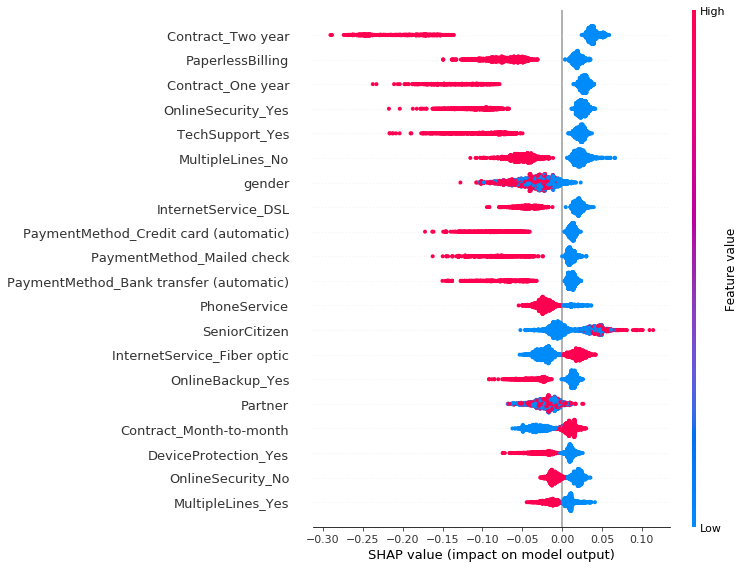

In [87]:
shap.summary_plot(shap_values[1], X_test)

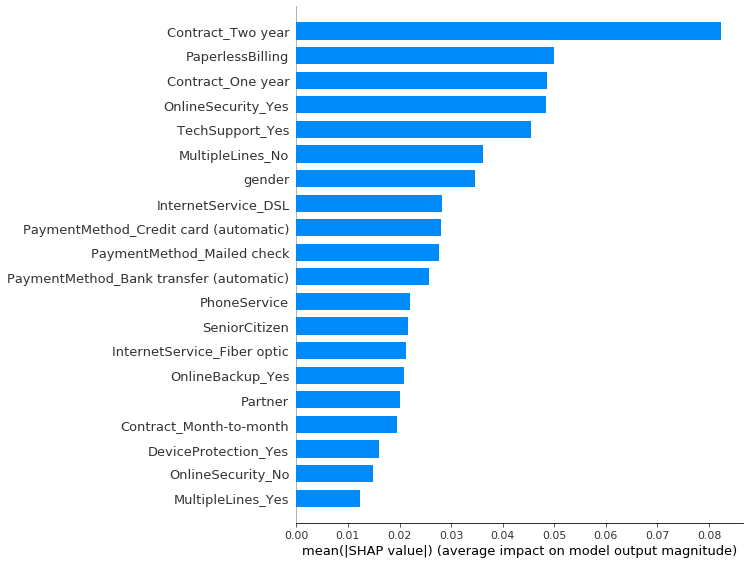

In [88]:
shap.summary_plot(shap_values[1], X_test, plot_type="bar")

In [89]:
exp_randforest = dx.Explainer(clf_randforest,x,y)
exp_randforest.model_performance().result
fobject_randforest = exp_randforest.model_fairness(protected = protected_values(x), privileged='maleyoung')
fobject_randforest.fairness_check(epsilon = 0.8)
fobject_randforest.metric_scores
fobject_randforest.plot()

Preparation of a new explainer is initiated

  -> data              : 7043 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 7043 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.295, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = -0.0296, max = 0.98
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteri

In [90]:
exp_randforest_rus = dx.Explainer(clf_randforest,X_rus,y_rus)
exp_randforest_rus.model_performance().result
fobject_randforest_rus = exp_randforest_rus.model_fairness(protected = protected_values(X_rus), privileged='maleyoung')
fobject_randforest_rus.fairness_check(epsilon = 0.8)
fobject_randforest_rus.metric_scores
fobject_randforest_rus.plot()
exp_randforest_rus.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 3738 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3738 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.443, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.99, mean = 0.0571, max = 0.98
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteri

,recall,precision,f1,accuracy,auc
RandomForestClassifier,0.8855,0.957201,0.919956,0.922953,0.976294


In [91]:
exp_randforest_ros = dx.Explainer(clf_randforest,X_ros,y_ros)
exp_randforest_ros.model_performance().result
fobject_randforest_ros = exp_randforest_ros.model_fairness(protected = protected_values(X_ros), privileged='maleyoung')
fobject_randforest_ros.fairness_check(epsilon = 0.8)
fobject_randforest_ros.metric_scores
fobject_randforest_ros.plot()
exp_randforest_ros.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.442, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.0579, max = 0.98
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criter

,recall,precision,f1,accuracy,auc
RandomForestClassifier,0.882296,0.951636,0.915655,0.918728,0.974044


In [92]:
exp_randforest_sm = dx.Explainer(clf_randforest,X_sm,y_sm)
exp_randforest_sm.model_performance().result
fobject_randforest_sm = exp_randforest_sm.model_fairness(protected = protected_values(X_sm), privileged='maleyoung')
fobject_randforest_sm.fairness_check(epsilon = 0.8)
fobject_randforest_sm.metric_scores
fobject_randforest_sm.plot()
exp_randforest_sm.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.497, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.00336, max = 0.98
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more crite

,recall,precision,f1,accuracy,auc
RandomForestClassifier,0.951102,0.954978,0.953036,0.953131,0.987965


In [93]:
exp_randforest_ada = dx.Explainer(clf_randforest,X_ada,y_ada)
exp_randforest_ada.model_performance().result
fobject_randforest_ada = exp_randforest_ada.model_fairness(protected = protected_values(X_ada), privileged='maleyoung')
fobject_randforest_ada.fairness_check(epsilon = 0.8)
fobject_randforest_ada.metric_scores
fobject_randforest_ada.plot()
exp_randforest_ada.model_performance().result

Preparation of a new explainer is initiated

  -> data              : 10408 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10408 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0, mean = 0.507, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = -0.00389, max = 0.99
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more crit

,recall,precision,f1,accuracy,auc
RandomForestClassifier,0.956248,0.9557,0.955974,0.955707,0.989025


# Bagging

In [94]:
from sklearn.ensemble import BaggingClassifier
model = BaggingClassifier()
clf_bagging = Pipeline([('transformer',ct),
                ('classifier', model)
               ])
clf_bagging.fit(X_train_rus,y_train_rus)
y_predict=clf_bagging.predict(X_test_rus)
print("Accuracy score:",metrics.accuracy_score(y_test_rus, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_rus,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_rus, y_predict))

Accuracy score: 0.7237076648841355

 confusion_matrix: 
 [[444 117]
 [193 368]]
classification_report:
               precision    recall  f1-score   support

           0       0.70      0.79      0.74       561
           1       0.76      0.66      0.70       561

    accuracy                           0.72      1122
   macro avg       0.73      0.72      0.72      1122
weighted avg       0.73      0.72      0.72      1122



In [95]:
clf_bagging.fit(X_train_ros,y_train_ros)
y_predict=clf_bagging.predict(X_test_ros)
print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict))

Accuracy score: 0.877938808373591

 confusion_matrix: 
 [[1288  246]
 [ 133 1438]]
classification_report:
               precision    recall  f1-score   support

           0       0.91      0.84      0.87      1534
           1       0.85      0.92      0.88      1571

    accuracy                           0.88      3105
   macro avg       0.88      0.88      0.88      3105
weighted avg       0.88      0.88      0.88      3105



In [96]:
from sklearn.ensemble import BaggingClassifier
model = BaggingClassifier()
clf_bagging = Pipeline([('transformer',ct),
                ('classifier', model)
               ])
clf_bagging.fit(X_train_sm,y_train_sm)
y_predict=clf_bagging.predict(X_test_sm)
print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict))

Accuracy score: 0.8444444444444444

 confusion_matrix: 
 [[1342  205]
 [ 278 1280]]
classification_report:
               precision    recall  f1-score   support

           0       0.83      0.87      0.85      1547
           1       0.86      0.82      0.84      1558

    accuracy                           0.84      3105
   macro avg       0.85      0.84      0.84      3105
weighted avg       0.85      0.84      0.84      3105



In [97]:
clf_bagging.fit(X_train_ada,y_train_ada)
y_predict=clf_bagging.predict(X_test_ada)
print("Accuracy score:",metrics.accuracy_score(y_test_ada, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ada,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ada, y_predict))

Accuracy score: 0.8411783541466539

 confusion_matrix: 
 [[1348  217]
 [ 279 1279]]
classification_report:
               precision    recall  f1-score   support

           0       0.83      0.86      0.84      1565
           1       0.85      0.82      0.84      1558

    accuracy                           0.84      3123
   macro avg       0.84      0.84      0.84      3123
weighted avg       0.84      0.84      0.84      3123



# SVM

In [98]:
from sklearn.svm import SVC
model = SVC(class_weight='balanced', probability=True)
clf_svm = Pipeline([('transformer',ct),
                ('classifier', model)
               ])
clf_svm.fit(X_train,y_train)
y_predict=clf_svm.predict(X_test)
print("Accuracy score:",metrics.accuracy_score(y_test, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test, y_predict))

Accuracy score: 0.7453857075248462

 confusion_matrix: 
 [[1153  407]
 [ 131  422]]
classification_report:
               precision    recall  f1-score   support

           0       0.90      0.74      0.81      1560
           1       0.51      0.76      0.61       553

    accuracy                           0.75      2113
   macro avg       0.70      0.75      0.71      2113
weighted avg       0.80      0.75      0.76      2113



In [99]:
from sklearn.svm import SVC
model = SVC(probability=True)
clf_svm = Pipeline([('transformer',ct),
                ('classifier', model)
               ])
clf_svm.fit(X_train,y_train)
y_predict=clf_svm.predict(X_test)

print("Accuracy score:",metrics.accuracy_score(y_test, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test, y_predict))

Accuracy score: 0.7988641741599621

 confusion_matrix: 
 [[1417  143]
 [ 282  271]]
classification_report:
               precision    recall  f1-score   support

           0       0.83      0.91      0.87      1560
           1       0.65      0.49      0.56       553

    accuracy                           0.80      2113
   macro avg       0.74      0.70      0.72      2113
weighted avg       0.79      0.80      0.79      2113



In [100]:
clf_svm.fit(X_train_ros,y_train_ros)
y_predict=clf_svm.predict(X_test_ros)
print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict))

Accuracy score: 0.7806763285024154

 confusion_matrix: 
 [[1144  390]
 [ 291 1280]]
classification_report:
               precision    recall  f1-score   support

           0       0.80      0.75      0.77      1534
           1       0.77      0.81      0.79      1571

    accuracy                           0.78      3105
   macro avg       0.78      0.78      0.78      3105
weighted avg       0.78      0.78      0.78      3105



In [101]:
clf_svm.fit(X_train_rus,y_train_rus)
y_predict=clf_svm.predict(X_test_rus)
print("Accuracy score:",metrics.accuracy_score(y_test_rus, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_rus,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_rus, y_predict))

Accuracy score: 0.7575757575757576

 confusion_matrix: 
 [[420 141]
 [131 430]]
classification_report:
               precision    recall  f1-score   support

           0       0.76      0.75      0.76       561
           1       0.75      0.77      0.76       561

    accuracy                           0.76      1122
   macro avg       0.76      0.76      0.76      1122
weighted avg       0.76      0.76      0.76      1122



In [102]:
clf_svm.fit(X_train_ros,y_train_ros)
y_predict=clf_svm.predict(X_test_ros)
print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict))

Accuracy score: 0.7806763285024154

 confusion_matrix: 
 [[1144  390]
 [ 291 1280]]
classification_report:
               precision    recall  f1-score   support

           0       0.80      0.75      0.77      1534
           1       0.77      0.81      0.79      1571

    accuracy                           0.78      3105
   macro avg       0.78      0.78      0.78      3105
weighted avg       0.78      0.78      0.78      3105



In [103]:
clf_svm.fit(X_train_sm,y_train_sm)
y_predict=clf_svm.predict(X_test_sm)
print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict))

Accuracy score: 0.8573268921095009

 confusion_matrix: 
 [[1355  192]
 [ 251 1307]]
classification_report:
               precision    recall  f1-score   support

           0       0.84      0.88      0.86      1547
           1       0.87      0.84      0.86      1558

    accuracy                           0.86      3105
   macro avg       0.86      0.86      0.86      3105
weighted avg       0.86      0.86      0.86      3105



In [104]:
clf_svm.fit(X_train_ada,y_train_ada)
y_predict=clf_svm.predict(X_test_ada)
print("Accuracy score:",metrics.accuracy_score(y_test_ada, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ada,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ada, y_predict))

Accuracy score: 0.8575088056356068

 confusion_matrix: 
 [[1382  183]
 [ 262 1296]]
classification_report:
               precision    recall  f1-score   support

           0       0.84      0.88      0.86      1565
           1       0.88      0.83      0.85      1558

    accuracy                           0.86      3123
   macro avg       0.86      0.86      0.86      3123
weighted avg       0.86      0.86      0.86      3123



In [105]:
exp_clf_svm = dx.Explainer(clf_svm,x,y,verbose = False)
fobject_clf_svm = exp_clf_svm.model_fairness(protected = protected_values(x), privileged='maleyoung')
fobject_clf_svm.fairness_check(epsilon = 0.8)
exp_clf_svm.model_performance()

Bias detected in 3 metrics: TPR, FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acceptable limits set by epsilon.

Ratios of metrics, based on 'maleyoung'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                  TPR       ACC       PPV       FPR       STP
femaleold    1.306159  0.919082  1.093272  2.359551  2.162437
femaleyoung  1.059783  0.993961  0.984709  1.146067  1.101523
maleold      1.304348  0.907005  1.051988  2.561798  2.182741


,recall,precision,f1,accuracy,auc
SVC,0.607277,0.663743,0.634255,0.814142,0.861085


In [106]:
fobject_clf_svm.plot()

In [107]:
exp_clf_svm_ros = dx.Explainer(clf_svm,X_ros,y_ros)
fobject_clf_svm_ros = exp_clf_svm_ros.model_fairness(protected = protected_values(X_ros), privileged='maleyoung')
fobject_clf_svm_ros.fairness_check(epsilon = 0.8)
fobject_clf_svm_ros.metric_scores
fobject_clf_svm_ros.plot()
exp_clf_svm.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0256, mean = 0.389, max = 0.972
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.935, mean = 0.111, max = 0.967
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 3 metrics: TPR, FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded

,recall,precision,f1,accuracy,auc
SVC,0.607277,0.663743,0.634255,0.814142,0.861085


In [108]:
exp_clf_svm_rus = dx.Explainer(clf_svm,X_rus,y_rus)
fobject_clf_svm_rus = exp_clf_svm_rus.model_fairness(protected = protected_values(X_rus), privileged='maleyoung')
fobject_clf_svm_rus.fairness_check(epsilon = 0.8)
fobject_clf_svm_rus.metric_scores
fobject_clf_svm_rus.plot()
exp_clf_svm_rus.model_performance()

Preparation of a new explainer is initiated

  -> data              : 3738 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3738 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0334, mean = 0.393, max = 0.972
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.93, mean = 0.107, max = 0.967
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 3 metrics: TPR, FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded ac

,recall,precision,f1,accuracy,auc
SVC,0.607277,0.847015,0.707385,0.748796,0.859037


In [109]:
exp_clf_svm_sm = dx.Explainer(clf_svm,X_sm,y_sm)
fobject_clf_svm_sm = exp_clf_svm_sm.model_fairness(protected = protected_values(X_sm), privileged='maleyoung')
fobject_clf_svm_sm.fairness_check(epsilon = 0.8)
fobject_clf_svm_sm.metric_scores
fobject_clf_svm_sm.plot()
exp_clf_svm_sm.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0256, mean = 0.503, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.935, mean = -0.00292, max = 0.967
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acc

,recall,precision,f1,accuracy,auc
SVC,0.83533,0.882581,0.858306,0.862099,0.942459


In [110]:
exp_clf_svm_ada = dx.Explainer(clf_svm,X_ada,y_ada)
fobject_clf_svm_ada = exp_clf_svm_ada.model_fairness(protected = protected_values(X_ada), privileged='maleyoung')
fobject_clf_svm_ada.fairness_check(epsilon = 0.8)
fobject_clf_svm_ada.metric_scores
fobject_clf_svm_ada.plot()
exp_clf_svm_ada.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10408 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10408 values
  -> model_class       : sklearn.svm._classes.SVC (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0256, mean = 0.503, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.935, mean = -0.000189, max = 0.967
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded ac

,recall,precision,f1,accuracy,auc
SVC,0.831295,0.883272,0.856496,0.859915,0.941563


# XG Boost

In [111]:
from xgboost import XGBClassifier
model = XGBClassifier()
clf_xgb = Pipeline([('transformer',ct),
                ('classifier', model)
               ])
clf_xgb.fit(X_train, y_train)
y_predict = clf_xgb.predict(X_test)

print("Accuracy score:",metrics.accuracy_score(y_test, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test, y_predict))

C:\Users\hp\Anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[08:52:10] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy score: 0.7893989588263133

 confusion_matrix: 
 [[1375  185]
 [ 260  293]]
classification_report:
               precision    recall  f1-score   support

           0       0.84      0.88      0.86      1560
           1       0.61      0.53      0.57       553

    accuracy                           0.79      2113
   macro avg       0.73      0.71      0.71      2113
weighted avg       0.78      0.79      0.78      2113



In [112]:
clf_xgb.fit(X_train_rus, y_train_rus)
y_predict = clf_xgb.predict(X_test_rus)


print("Accuracy score:",metrics.accuracy_score(y_test_rus, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_rus,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_rus, y_predict))


[08:52:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\hp\Anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Accuracy score: 0.7335115864527629

 confusion_matrix: 
 [[409 152]
 [147 414]]
classification_report:
               precision    recall  f1-score   support

           0       0.74      0.73      0.73       561
           1       0.73      0.74      0.73       561

    accuracy                           0.73      1122
   macro avg       0.73      0.73      0.73      1122
weighted avg       0.73      0.73      0.73      1122



In [113]:
clf_xgb.fit(X_train_ros, y_train_ros)
y_predict = clf_xgb.predict(X_test_ros)


print("Accuracy score:",metrics.accuracy_score(y_test_ros, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ros,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ros, y_predict))


[08:52:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\hp\Anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Accuracy score: 0.8444444444444444

 confusion_matrix: 
 [[1197  337]
 [ 146 1425]]
classification_report:
               precision    recall  f1-score   support

           0       0.89      0.78      0.83      1534
           1       0.81      0.91      0.86      1571

    accuracy                           0.84      3105
   macro avg       0.85      0.84      0.84      3105
weighted avg       0.85      0.84      0.84      3105



In [114]:
from xgboost import XGBClassifier
model = XGBClassifier()
clf_xgb = Pipeline([('transformer',ct),
                ('classifier', model)
               ])
clf_xgb.fit(X_train_sm, y_train_sm)
y_predict = clf_xgb.predict(X_test_sm)


print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict))


[08:52:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\hp\Anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Accuracy score: 0.8544283413848631

 confusion_matrix: 
 [[1325  222]
 [ 230 1328]]
classification_report:
               precision    recall  f1-score   support

           0       0.85      0.86      0.85      1547
           1       0.86      0.85      0.85      1558

    accuracy                           0.85      3105
   macro avg       0.85      0.85      0.85      3105
weighted avg       0.85      0.85      0.85      3105



In [115]:
clf_xgb.fit(X_train_ada, y_train_ada)
y_predict = clf_xgb.predict(X_test_ada)


print("Accuracy score:",metrics.accuracy_score(y_test_ada, y_predict))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_ada,y_predict,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_ada, y_predict))


[08:52:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\hp\Anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



Accuracy score: 0.8578290105667628

 confusion_matrix: 
 [[1342  223]
 [ 221 1337]]
classification_report:
               precision    recall  f1-score   support

           0       0.86      0.86      0.86      1565
           1       0.86      0.86      0.86      1558

    accuracy                           0.86      3123
   macro avg       0.86      0.86      0.86      3123
weighted avg       0.86      0.86      0.86      3123



In [116]:
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train_sm),
    feature_names=X_train_sm.columns,
    mode='classification'
)

exp = explainer.explain_instance(
    data_row=X_test.iloc[100], 
    predict_fn=clf_xgb['classifier'].predict_proba
)
exp.show_in_notebook(show_table=True)

In [117]:
shap.initjs()
shap_explainer = shap.TreeExplainer(clf_xgb['classifier'])
shap_values = shap_explainer.shap_values(X_test)
shap.force_plot(shap_explainer.expected_value, shap_values[0,:], X_test.iloc[0,:])

C:\Users\hp\Anaconda3\lib\site-packages\xgboost\core.py:104: UserWarning:

ntree_limit is deprecated, use `iteration_range` or model slicing instead.



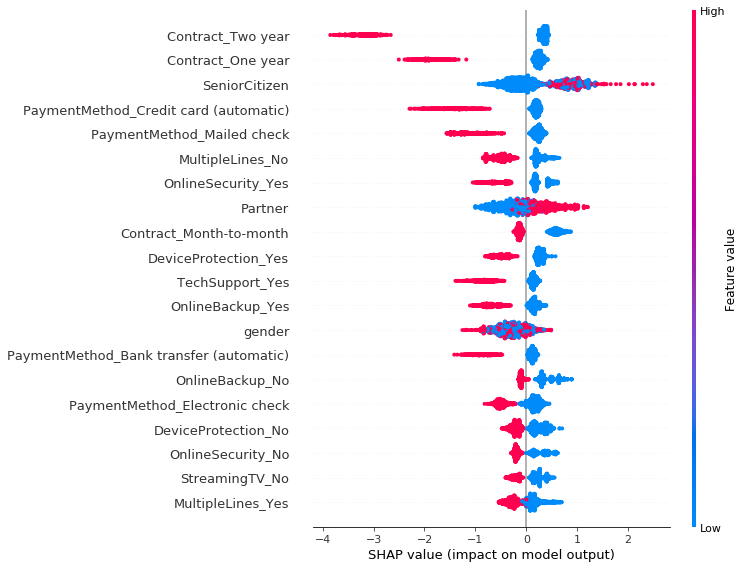

In [118]:
shap.summary_plot(shap_values, X_test)

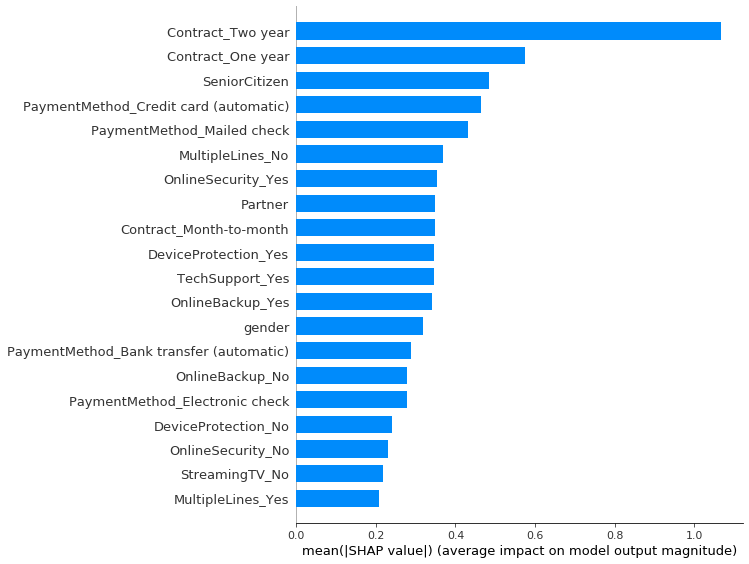

In [119]:
shap.summary_plot(shap_values, X_test, plot_type="bar")

In [120]:
exp_clf_xgb = dx.Explainer(clf_xgb,x,y,verbose = False)
fobject_clf_xgb = exp_clf_xgb.model_fairness(protected = protected_values(x), privileged='maleyoung')
fobject_clf_xgb.fairness_check(epsilon = 0.8)
exp_clf_xgb.model_performance()

Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acceptable limits set by epsilon.

Ratios of metrics, based on 'maleyoung'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                  TPR       ACC       PPV       FPR       STP
femaleold    1.117722  0.973510  1.049689  2.051724  1.938596
femaleyoung  0.997468  0.988962  0.967702  1.206897  1.061404
maleold      1.121519  0.979029  1.050932  1.931034  1.885965


,recall,precision,f1,accuracy,auc
XGBClassifier,0.813269,0.805938,0.809587,0.898481,0.945428


In [121]:
fobject_clf_xgb.plot()

In [122]:
exp_clf_xgb_rus = dx.Explainer(clf_xgb,X_rus,y_rus)
exp_clf_xgb_rus.model_performance().result
fobject_clf_xgb_rus = exp_clf_xgb_rus.model_fairness(protected = protected_values(X_rus), privileged='maleyoung')
fobject_clf_xgb_rus.fairness_check(epsilon = 0.8)
fobject_clf_xgb_rus.metric_scores
fobject_clf_xgb_rus.plot()

Preparation of a new explainer is initiated

  -> data              : 3738 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3738 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 8.75e-05, mean = 0.413, max = 0.992
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.952, mean = 0.0872, max = 0.995
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceede

In [123]:
exp_clf_xgb_ros = dx.Explainer(clf_xgb,X_ros,y_ros)
exp_clf_xgb_ros.model_performance().result
fobject_clf_xgb_ros = exp_clf_xgb_ros.model_fairness(protected = protected_values(X_ros), privileged='maleyoung')
fobject_clf_xgb_ros.fairness_check(epsilon = 0.8)
fobject_clf_xgb_ros.metric_scores
fobject_clf_xgb_ros.plot()
exp_clf_xgb_ros.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 6.9e-05, mean = 0.411, max = 0.992
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.964, mean = 0.0891, max = 0.995
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceed

,recall,precision,f1,accuracy,auc
XGBClassifier,0.811944,0.91986,0.86254,0.870603,0.945294


In [124]:
exp_clf_xgb_sm = dx.Explainer(clf_xgb,X_sm,y_sm)
exp_clf_xgb_sm.model_performance().result
fobject_clf_xgb_sm = exp_clf_xgb_sm.model_fairness(protected = protected_values(X_sm), privileged='maleyoung')
fobject_clf_xgb_sm.fairness_check(epsilon = 0.8)
fobject_clf_xgb_sm.metric_scores
fobject_clf_xgb_sm.plot()
exp_clf_xgb_sm.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 6.9e-05, mean = 0.5, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.964, mean = -0.000179, max = 0.995
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceede

,recall,precision,f1,accuracy,auc
XGBClassifier,0.928682,0.929221,0.928951,0.928972,0.978617


In [125]:
exp_clf_xgb_ada = dx.Explainer(clf_xgb,X_ada,y_ada)
exp_clf_xgb_ada.model_performance().result
fobject_clf_xgb_ada = exp_clf_xgb_ada.model_fairness(protected = protected_values(X_ada), privileged='maleyoung')
fobject_clf_xgb_ada.fairness_check(epsilon = 0.8)
fobject_clf_xgb_ada.metric_scores
fobject_clf_xgb_ada.plot()

Preparation of a new explainer is initiated

  -> data              : 10408 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10408 values
  -> model_class       : xgboost.sklearn.XGBClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 6.9e-05, mean = 0.505, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.964, mean = -0.00171, max = 0.995
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceed

# ANN

In [132]:
import keras
import tensorflow as tf    
tf.compat.v1.disable_v2_behavior()
from keras.models import Sequential
from keras.layers import Dense
classifier= tf.keras.models.Sequential()
classifier.add(tf.keras.layers.Dense(6,kernel_initializer='uniform', input_dim=len(X_train.columns), activation="relu"))
                     
classifier.add(tf.keras.layers.Dense(6, kernel_initializer='uniform',
                     activation = 'relu'))
classifier.add(tf.keras.layers.Dense(1, kernel_initializer='uniform', 
                     activation = 'sigmoid'))
classifier.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])
classifier.fit(X_train, y_train,epochs=100, batch_size=16, verbose=2)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Train on 4930 samples
Epoch 1/100
4930/4930 - 0s - loss: 0.5717 - acc: 0.7288
Epoch 2/100
4930/4930 - 0s - loss: 0.5453 - acc: 0.7331
Epoch 3/100
4930/4930 - 0s - loss: 0.4879 - acc: 0.7828
Epoch 4/100
4930/4930 - 0s - loss: 0.4719 - acc: 0.7917
Epoch 5/100
4930/4930 - 0s - loss: 0.4565 - acc: 0.7923
Epoch 6/100
4930/4930 - 0s - loss: 0.4443 - acc: 0.7980
Epoch 7/100
4930/4930 - 0s - loss: 0.4441 - acc: 0.7951
Epoch 8/100
4930/4930 - 0s - loss: 0.4394 - acc: 0.7998
Epoch 9/100
4930/4930 - 0s - loss: 0.4360 - acc: 0.8000
Epoch 10/100
4930/4930 - 0s - loss: 0.4361 - acc: 0.8024
Epoch 11/100
4930/4930 - 0s - loss: 0.4331 - acc: 0.7980
Epoch 12/100
4930/4930 - 0s - loss: 0.4318 - acc: 0.7974
Epoch 13/100
4930/4930 - 0s - loss: 0.4343 - acc: 0.7994
Epoch 14/100
4930/4930 - 0s - loss: 0.4328 - acc: 0.8010
Epoch 15/100
4930/4930 - 0s - loss: 0.4282 - acc: 0.8032
Epoch 16/100
4

In [127]:
_, accuracy = classifier.evaluate(X_test, y_test, verbose=0)
print('Accuracy: %.2f' % (accuracy*100))

Accuracy: 80.12


In [128]:
def prob(data):
    print(data.shape)
    y_pred=classifier.predict(data).reshape(-1, 1)
    y_pred =(y_pred>0.5)
    print(np.array(list(zip(1-y_pred.reshape(data.shape[0]),y_pred.reshape(data.shape[0])))))
    return np.hstack((1-y_pred,y_pred))

In [129]:
exp = explainer.explain_instance(
    data_row=X_test.iloc[100], 
    predict_fn=prob
)
exp.show_in_notebook(show_table=True)

(5000, 32)
[[0 1]
 [1 0]
 [0 1]
 ...
 [1 0]
 [1 0]
 [1 0]]


In [133]:
background = X_train.iloc[np.random.choice(X_train.shape[0], 100, replace=False)]

explainer = shap.DeepExplainer(
    (classifier.layers[0].input, classifier.layers[-1].output), background)

shap_values = explainer.shap_values(X_test[:3].values) 

# print the JS visualization code to the notebook
shap.initjs()
shap.force_plot(
    explainer.expected_value[0], shap_values[0][0], feature_names=X_train.columns
)


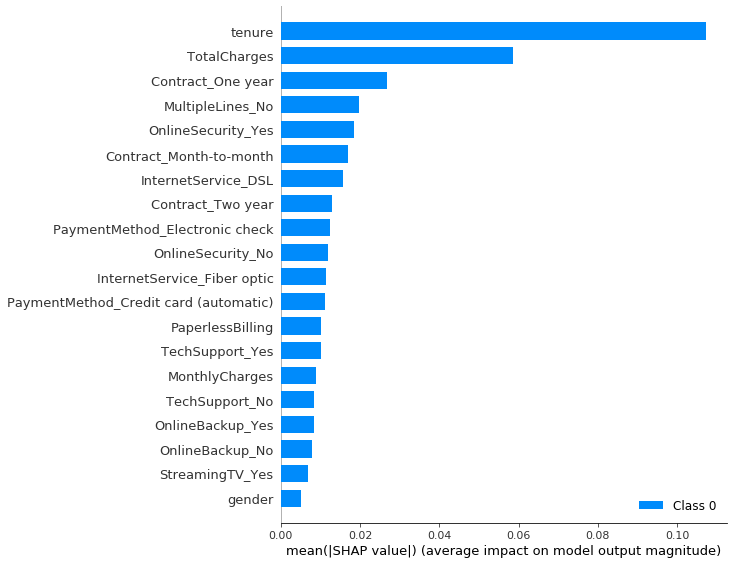

In [134]:
shap.summary_plot(shap_values, X_test)

# Hybrid classifier

In [135]:
from sklearn.ensemble import VotingClassifier
log_clf=LogisticRegression()
rnd_clf = RandomForestClassifier()
svc_clf=SVC()
vot_clf=VotingClassifier(estimators=[('lr', log_clf), ('rnd', rnd_clf),
                                     ('svc', svc_clf)], voting = 'hard')

In [136]:
Hyb_vot_clf = Pipeline([('transformer',ct),
                ('classifier', vot_clf)
               ])

In [137]:
Hyb_vot_clf.fit(X_train_sm,y_train_sm)

C:\Users\hp\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:765: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('somename', StandardScaler(),
                                                  ['tenure', 'MonthlyCharges',
                                                   'TotalCharges'])])),
                ('classifier',
                 VotingClassifier(estimators=[('lr', LogisticRegression()),
                                              ('rnd', RandomForestClassifier()),
                                              ('svc', SVC())]))])

In [138]:
y_predict_hyb=Hyb_vot_clf.predict(X_test_sm)

In [139]:
print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict_hyb))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict_hyb,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict_hyb))

Accuracy score: 0.8595813204508856

 confusion_matrix: 
 [[1345  202]
 [ 234 1324]]
classification_report:
               precision    recall  f1-score   support

           0       0.85      0.87      0.86      1547
           1       0.87      0.85      0.86      1558

    accuracy                           0.86      3105
   macro avg       0.86      0.86      0.86      3105
weighted avg       0.86      0.86      0.86      3105



In [140]:
from sklearn.ensemble import VotingClassifier
log_clf=LogisticRegression()
rnd_clf = RandomForestClassifier()
svc_clf=SVC(probability=True)
vot_clf=VotingClassifier(estimators=[('lr', log_clf), ('rnd', rnd_clf),
                                     ('svc', svc_clf)], voting = 'soft')
Hyb_vot_clf = Pipeline([('transformer',ct),
                ('classifier', vot_clf)
               ])
Hyb_vot_clf.fit(X_train_sm,y_train_sm)
y_predict_hyb=Hyb_vot_clf.predict(X_test_sm)
print("Accuracy score:",metrics.accuracy_score(y_test_sm, y_predict_hyb))
print("\n confusion_matrix: \n",metrics.confusion_matrix(y_test_sm,y_predict_hyb,labels = [0, 1]))
print("classification_report:\n",metrics.classification_report(y_test_sm, y_predict_hyb))

C:\Users\hp\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:765: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Accuracy score: 0.8621578099838969

 confusion_matrix: 
 [[1339  208]
 [ 220 1338]]
classification_report:
               precision    recall  f1-score   support

           0       0.86      0.87      0.86      1547
           1       0.87      0.86      0.86      1558

    accuracy                           0.86      3105
   macro avg       0.86      0.86      0.86      3105
weighted avg       0.86      0.86      0.86      3105



In [141]:
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train_sm),
    feature_names=X_train_sm.columns,
    mode='classification'
)

exp = explainer.explain_instance(
    data_row=X_test.iloc[100], 
    predict_fn=Hyb_vot_clf['classifier'].predict_proba
)
exp.show_in_notebook(show_table=True)

In [142]:
exp_Hyb_vot_clf = dx.Explainer(Hyb_vot_clf,x,y)
fobject_Hyb_vot_clf = exp_Hyb_vot_clf.model_fairness(protected = protected_values(x), privileged='maleyoung')
fobject_Hyb_vot_clf.fairness_check(epsilon = 0.8)
exp_Hyb_vot_clf.model_performance()

Preparation of a new explainer is initiated

  -> data              : 7043 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 7043 values
  -> model_class       : sklearn.ensemble._voting.VotingClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0192, mean = 0.3, max = 0.94
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.91, mean = -0.0347, max = 0.96
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria e

,recall,precision,f1,accuracy,auc
VotingClassifier,0.695559,0.731159,0.712915,0.851342,0.928043


In [143]:
fobject_Hyb_vot_clf.plot()

In [144]:
exp_Hyb_vot_clf_rus = dx.Explainer(Hyb_vot_clf,X_rus,y_rus)
exp_Hyb_vot_clf_rus.model_performance().result
fobject_Hyb_vot_clf_rus = exp_Hyb_vot_clf_rus.model_fairness(protected = protected_values(X_rus), privileged='maleyoung')
fobject_Hyb_vot_clf_rus.fairness_check(epsilon = 0.8)
fobject_Hyb_vot_clf_rus.metric_scores
fobject_Hyb_vot_clf_rus.plot()
exp_Hyb_vot_clf_rus.model_performance()

Preparation of a new explainer is initiated

  -> data              : 3738 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 3738 values
  -> model_class       : sklearn.ensemble._voting.VotingClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0231, mean = 0.406, max = 0.94
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.91, mean = 0.0944, max = 0.96
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria 

,recall,precision,f1,accuracy,auc
VotingClassifier,0.695559,0.884956,0.77891,0.802568,0.928619


In [145]:
exp_Hyb_vot_clf_ros = dx.Explainer(Hyb_vot_clf,X_ros,y_ros)
exp_Hyb_vot_clf_ros.model_performance().result
fobject_Hyb_vot_clf_ros = exp_Hyb_vot_clf_ros.model_fairness(protected = protected_values(X_ros), privileged='maleyoung')
fobject_Hyb_vot_clf_ros.fairness_check(epsilon = 0.8)
fobject_Hyb_vot_clf_ros.metric_scores
fobject_Hyb_vot_clf_ros.plot()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.ensemble._voting.VotingClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0192, mean = 0.403, max = 0.94
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.91, mean = 0.0968, max = 0.96
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteri

In [146]:
exp_Hyb_vot_clf_sm = dx.Explainer(Hyb_vot_clf,X_sm,y_sm)
exp_Hyb_vot_clf_sm.model_performance().result
fobject_Hyb_vot_clf_sm = exp_Hyb_vot_clf_sm.model_fairness(protected = protected_values(X_sm), privileged='maleyoung')
fobject_Hyb_vot_clf_sm.fairness_check(epsilon = 0.8)
fobject_Hyb_vot_clf_sm.metric_scores
fobject_Hyb_vot_clf_sm.plot()
exp_Hyb_vot_clf_sm.model_performance()

Preparation of a new explainer is initiated

  -> data              : 10348 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10348 values
  -> model_class       : sklearn.ensemble._voting.VotingClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0192, mean = 0.503, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.91, mean = -0.00284, max = 0.96
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criter

,recall,precision,f1,accuracy,auc
VotingClassifier,0.881136,0.905102,0.892959,0.894376,0.971473


In [149]:
exp_Hyb_vot_clf_ada = dx.Explainer(Hyb_vot_clf,X_ada,y_ada)
exp_Hyb_vot_clf_ada.model_performance().result
fobject_Hyb_vot_clf_ada = exp_Hyb_vot_clf_ada.model_fairness(protected = protected_values(X_ada), privileged='maleyoung')
fobject_Hyb_vot_clf_ada.fairness_check(epsilon = 0.8)
fobject_Hyb_vot_clf_ada.metric_scores
fobject_Hyb_vot_clf_ada.plot()

Preparation of a new explainer is initiated

  -> data              : 10408 rows 32 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 10408 values
  -> model_class       : sklearn.ensemble._voting.VotingClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x00000112CB3CF048> will be used (default)
  -> predict function  : Accepts only pandas.DataFrame, numpy.ndarray causes problems.
  -> predicted values  : min = 0.0192, mean = 0.498, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.91, mean = 0.00487, max = 0.96
  -> model_info        : package sklearn

A new explainer has been created!
Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteri

# comparision

In [155]:
fobject.plot(objects=[fobject_randforest,fobject_logreg,fobject_clf_xgb,fobject_clf_svm,fobject_Hyb_vot_clf])


Found NaN's or 0's for models: {'RandomForestClassifier'}
It is advisable to check 'metric_ratios'


In [156]:
fobject.plot(objects=[fobject_randforest,fobject_logreg,fobject_clf_xgb,fobject_clf_svm,fobject_Hyb_vot_clf],
             type='metric_scores')

In [215]:
fobject.plot(objects=[fobject_randforest,fobject_logreg,fobject_clf_xgb,fobject_clf_svm,fobject_Hyb_vot_clf],
             type="performance_and_fairness",fairness_metric="FNR",performance_metric="auc")

Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs


In [216]:
fobject.plot(objects=[fobject_randforest,fobject_logreg,fobject_clf_xgb,fobject_clf_svm,fobject_Hyb_vot_clf],
             type="radar")

In [217]:
fobject.plot(objects=[fobject_randforest,fobject_logreg,fobject_clf_xgb,fobject_clf_svm,fobject_Hyb_vot_clf],
             type="stacked")

In [218]:
fobject.plot(objects=[fobject_randforest,fobject_logreg,fobject_clf_xgb,fobject_clf_svm,fobject_Hyb_vot_clf],
             type="heatmap")

In [219]:
fobject_sm.plot(objects=[fobject_randforest_sm,fobject_logreg_sm,fobject_clf_xgb_sm,fobject_clf_svm_sm,
                         fobject_Hyb_vot_clf_sm],type="performance_and_fairness",
                fairness_metric="FNR",performance_metric="auc")

Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs


In [220]:
fobject_sm.plot(objects=[fobject_randforest_sm,fobject_logreg_sm,fobject_clf_xgb_sm,fobject_clf_svm_sm,
                         fobject_Hyb_vot_clf_sm],type="radar")

In [221]:
fobject_sm.plot(objects=[fobject_randforest_sm,fobject_logreg_sm,fobject_clf_xgb_sm,fobject_clf_svm_sm,
                         fobject_Hyb_vot_clf_sm],type="heatmap")

In [222]:
fobject_sm.plot(objects=[fobject_randforest_sm,fobject_logreg_sm,fobject_clf_xgb_sm,fobject_clf_svm_sm,
                         fobject_Hyb_vot_clf_sm],type="stacked")

In [223]:
fobject_randforest_ros.plot(objects=[fobject_clf_xgb_ros,fobject_clf_svm_ros,fobject_ros,fobject_Hyb_vot_clf_ros,fobject_logreg_ros],
                            type="performance_and_fairness",fairness_metric="FNR",performance_metric="auc")

Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs


In [224]:
fobject_ros.plot(objects=[fobject_randforest_ros,fobject_clf_xgb_ros,fobject_clf_svm_ros,fobject_Hyb_vot_clf_ros,fobject_logreg_ros],
                         type="performance_and_fairness",fairness_metric="FNR",performance_metric="auc")

Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs


In [192]:
fobject_ros.plot(objects=[fobject_randforest_ros,fobject_clf_xgb_ros,fobject_clf_svm_ros,
                         fobject_Hyb_vot_clf_ros,fobject_logreg_ros],type="radar")

In [194]:
fobject_ros.plot(objects=[fobject_randforest_ros,fobject_clf_xgb_ros,fobject_clf_svm_ros,
                         fobject_Hyb_vot_clf_ros,fobject_logreg_ros],type="stacked")

In [225]:
fobject_rus.plot(objects=[fobject_randforest_rus,fobject_clf_xgb_rus,fobject_clf_svm_rus,
                         fobject_Hyb_vot_clf_rus,fobject_logreg_rus],type="performance_and_fairness",
                 fairness_metric="FNR",performance_metric="auc")

Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs


In [210]:
fobject_rus.plot(objects=[fobject_randforest_rus,fobject_clf_xgb_rus,fobject_clf_svm_rus,
                         fobject_Hyb_vot_clf_rus,fobject_logreg_rus],type="stacked"
                         )

In [226]:
fobject_ada.plot(objects=[fobject_randforest_ada,fobject_clf_xgb_ada,fobject_clf_svm_ada,
                         fobject_Hyb_vot_clf_ada,fobject_logreg_ada],type="performance_and_fairness",
                         fairness_metric="FNR",performance_metric="auc")

Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs
Beware, that auc metric is insensitive to cutoffs


In [198]:
fobject_ada.plot(objects=[fobject_randforest_ada,fobject_clf_xgb_ada,fobject_clf_svm_ada,
                         fobject_Hyb_vot_clf_ada,fobject_logreg_ada],type="stacked")

In [204]:
pd.concat([exp.model_performance().result for exp in [exp_logreg,exp_decision,exp_randforest,exp_clf_svm,exp_clf_xgb,exp_Hyb_vot_clf]])

,recall,precision,f1,accuracy,auc
LogisticRegression,0.596041,0.624790,0.610077,0.797813,0.841175
DecisionTreeClassifier,0.872124,0.829517,0.850287,0.918501,0.905740
RandomForestClassifier,0.885500,0.877054,0.881257,0.936675,0.974096
SVC,0.607277,0.663743,0.634255,0.814142,0.861085
XGBClassifier,0.813269,0.805938,0.809587,0.898481,0.945428
VotingClassifier,0.695559,0.731159,0.712915,0.851342,0.928043


In [205]:
pd.concat([exp.model_performance().result for exp in [exp_logreg_rus,exp_decision_rus,exp_randforest_rus,exp_clf_svm_rus,
                                                      exp_clf_xgb_rus,exp_Hyb_vot_clf_rus]])

,recall,precision,f1,accuracy,auc
LogisticRegression,0.615302,0.814448,0.701006,0.737560,0.840233
DecisionTreeClassifier,0.872124,0.931429,0.900801,0.903959,0.932894
RandomForestClassifier,0.885500,0.957201,0.919956,0.922953,0.976294
SVC,0.607277,0.847015,0.707385,0.748796,0.859037
XGBClassifier,0.813269,0.921212,0.863882,0.871857,0.946157
VotingClassifier,0.695559,0.884956,0.778910,0.802568,0.928619


In [206]:
pd.concat([exp.model_performance().result for exp in [exp_logreg_ros,exp_decision_ros,exp_randforest_ros,exp_clf_svm_ros,
                                                      exp_clf_xgb_ros,exp_Hyb_vot_clf_ros]])

,recall,precision,f1,accuracy,auc
LogisticRegression,0.608813,0.815640,0.697211,0.735601,0.840150
DecisionTreeClassifier,0.867801,0.930570,0.898090,0.901527,0.934425
RandomForestClassifier,0.882296,0.951636,0.915655,0.918728,0.974044
SVC,0.597603,0.843196,0.699468,0.743235,0.858369
XGBClassifier,0.811944,0.919860,0.862540,0.870603,0.945294
VotingClassifier,0.683224,0.880887,0.769566,0.795419,0.926715


In [207]:
pd.concat([exp.model_performance().result for exp in [exp_logreg_sm,exp_decision_sm,exp_randforest_sm,exp_clf_svm_sm,
                                                      exp_clf_xgb_sm,exp_Hyb_vot_clf_sm]])

,recall,precision,f1,accuracy,auc
LogisticRegression,0.839003,0.859094,0.848929,0.850696,0.935735
DecisionTreeClassifier,0.929842,0.934901,0.932364,0.932547,0.940384
RandomForestClassifier,0.951102,0.954978,0.953036,0.953131,0.987965
SVC,0.835330,0.882581,0.858306,0.862099,0.942459
XGBClassifier,0.928682,0.929221,0.928951,0.928972,0.978617
VotingClassifier,0.881136,0.905102,0.892959,0.894376,0.971473


In [208]:
pd.concat([exp.model_performance().result for exp in [exp_logreg_ada,exp_decision_ada,exp_randforest_ada,exp_clf_svm_ada,
                                                      exp_clf_xgb_ada,exp_Hyb_vot_clf_ada]])

,recall,precision,f1,accuracy,auc
LogisticRegression,0.835690,0.860008,0.847674,0.848962,0.934995
DecisionTreeClassifier,0.944402,0.936529,0.940449,0.939854,0.952197
RandomForestClassifier,0.956248,0.955700,0.955974,0.955707,0.989025
SVC,0.831295,0.883272,0.856496,0.859915,0.941563
XGBClassifier,0.930264,0.930086,0.930175,0.929766,0.979170
VotingClassifier,0.872182,0.905215,0.888392,0.889796,0.969765
